In [5]:
#######################################################################
# Copyright (C)                                                       #
# 2020 Hongjia Liu(piperliu@qq.com)                                   #
# Permission given to modify the code as long as you keep this        #
# declaration at the top                                              #
#######################################################################

import networkx as nx
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import pandas as pd

from tqdm import trange
import numpy as np

# from __future__ import absolute_import
import os
import sys
this_dir = os.getcwd()
# this_dir = osp.dirname(__file__)
print(this_dir)
path = os.path.join(this_dir)
sys.path.append(path)

d:\GitHub\BA_network-SEIR-Sim


In [6]:
from family import *
# using ba network
def return_family_list(n=1000, m=5, seed=0):
    # generate fam_list
    G = nx.random_graphs.barabasi_albert_graph(n, m, seed)
    fam_list = list()
    adj = list(G.edges())
    for g in G:
        fam = family(label=g)
        fam_list.append(fam)
    for g_1, g_2 in adj:
        f_1 = fam_list[g_1]
        f_2 = fam_list[g_2]
        f_1.relate(f_2)
    return fam_list, G

### 实验1：流动意向与传播程度关系

In [7]:
from calculator import *
# @return:  illed people [runs:[theta:[day:[state]]]]
# /= runs for average
def experiment_1_THETA(fam_list, THETAs, INFECT_INIT=30, days=10, runs=30):
    cal = Calculator(fam_list)
    states_each_experiment = list()
    
    states_each_experiment = np.zeros((runs, THETAs.shape[0], days, len(fam_list)))
    for r in range(runs):
        for t in trange(len(THETAs)):
            theta = THETAs[t]
            # print("theta: " + str(theta))
            paras.THETA = theta
            cal.cls()
            infects = []
            while len(infects) < INFECT_INIT:
                i = np.random.randint(0, len(fam_list))
                infects.append(i)
            for i in infects:
                fam_list[i].state = 5
            # cal.next_iter(days) returns [day:[state, state, state]]
            each_experiment = np.array(cal.next_iter(days))
            # each_experiment = [sum(data!=0) for data in each_experiment]
            states_each_experiment[r, t] = states_each_experiment[r, t] + each_experiment
    return states_each_experiment

In [8]:
fam_list, G = return_family_list()

In [9]:
# experiment 1.0
days = 50
THETAs = np.asarray([0.0001, 0.0005, 0.001, 0.005, 0.01, 0.02, 0.03, 0.05, 0.1, 0.5])
ex_0_data = experiment_1_THETA(fam_list, days=days, THETAs=THETAs)

100%|██████████| 10/10 [00:01<00:00,  6.12it/s]


In [10]:
# experiment 1.0
# data
run_theta_day_state = np.where(ex_0_data==0, 0, 1)

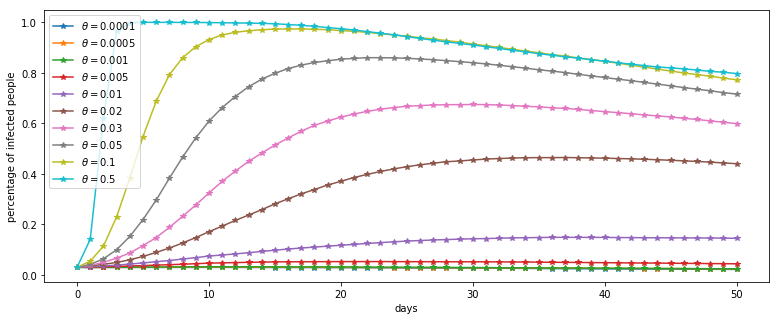

In [11]:
# show results
theta_day = run_theta_day_state.mean(axis=0).mean(axis=2)

fig, axes = plt.subplots(figsize=(13, 5))
for t, theta in enumerate(THETAs):
    plt.plot(np.arange(0, days+1), [30/1000] + list(theta_day[t, :]), '*-')
plt.xlabel('days')
plt.ylabel('percentage of infected people')
plt.legend([r'$\theta=$' + str(theta) for theta in THETAs])
plt.show()

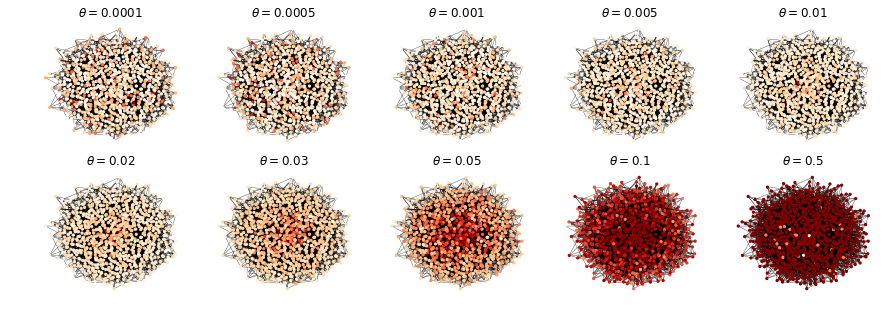

In [12]:
# show nx draw
# plot nodes on plt based on networkx
DAY = 10

fig, axes = plt.subplots(2, 5, figsize=(15, 5))
for i, t in enumerate(THETAs):
    states = run_theta_day_state[:, i, DAY-1, :].mean(axis=0)
    plt.subplot(2, 5, i+1)
    nx.draw(G, node_size=5, node_color=states, width=0.3, pos=nx.spring_layout(G, random_state=1), cmap=plt.cm.OrRd)
    plt.title(r'$\theta=$' + str(t))
plt.show()

上图结点越深，说明该结点患病概率越高。

可以看出，当 $\theta$ 值不大于 0.01 时，疫情传播并不严重。

### 实验2：网络结构紧密后（连接更多后），传播是否更容易

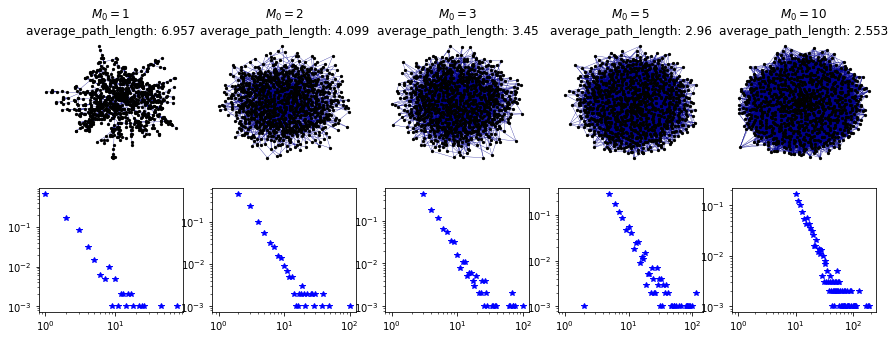

In [13]:
# observe
Ms = [1, 2, 3, 5, 10]

fig, axes = plt.subplots(2, 5, figsize=(15, 5))
for i, M in enumerate(Ms):
    fam_list, G = return_family_list(m=M)
    plt.subplot(2, 5, i+1)
    nx.draw(G, node_size=5, node_color='#000000', edge_color='#00008B', width=0.3, pos=nx.spring_layout(G, random_state=1))
    plt.title(r'$M_0=$' + str(M) + '\n' + 'average_path_length: ' + str(round(nx.average_shortest_path_length(G), 3)))
    plt.subplot(2, 5, i+6)
    d = nx.degree_histogram(G)
    x = range(len(d))           
    y = [z / float(sum(d)) for z in d]
    plt.loglog(x, y, 'b*')
plt.show()

如上，当参数 $M_0$ (Number of edges to attach from a new node to existing nodes) 提升时（社会组织结构更紧密），两点间平均距离也变小。

度都是呈幂律分布。

In [14]:
# experiment
from calculator import *
# @return:  illed people [runs:[M_0:[day:[state]]]]
# /= runs for average
def experiment_2_M0(Ms=[1, 2, 3, 5, 10], INFECT_INIT=30, days=10, runs=30, theta=0.1):
    states_each_experiment = np.zeros((runs, len(Ms), days, 1000))
    paras.THETA = theta
    for m, M in enumerate(Ms):
        fam_list, G = return_family_list(n=1000, m=M)
        cal = Calculator(fam_list)

        for r in trange(runs):
            cal.cls()
            infects = []
            while len(infects) < INFECT_INIT:
                i = np.random.randint(0, len(fam_list))
                infects.append(i)
            for i in infects:
                fam_list[i].state = 5
            # cal.next_iter(days) returns [day:[state, state, state]]
            each_experiment = np.array(cal.next_iter(days))
            states_each_experiment[r, m] = each_experiment
    return states_each_experiment

In [15]:
# experiment 2
ex_2_data = experiment_2_M0()

100%|██████████| 30/30 [00:03<00:00,  7.99it/s]


In [16]:
# data
run_M0_day_state = np.where(ex_2_data==0, 0, 1)

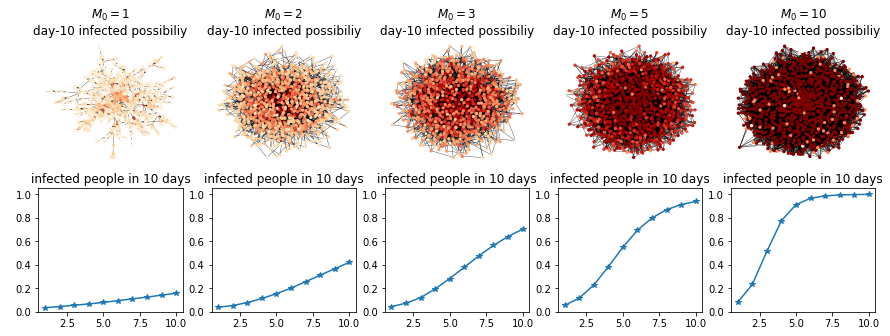

In [17]:
# show results
Ms=[1, 2, 3, 5, 10]
M0_day = run_M0_day_state.mean(axis=0).mean(axis=2)

fig, axes = plt.subplots(2, 5, figsize=(15, 5))
for i, M in enumerate(Ms):
    fam_list, G = return_family_list(m=M)
    plt.subplot(2, 5, i+1)
    states = run_M0_day_state[:, i, 9, :].mean(axis=0)
    nx.draw(G, node_size=5, node_color=states, width=0.3, pos=nx.spring_layout(G, random_state=1), cmap=plt.cm.OrRd)
    plt.title(r'$M_0=$' + str(M) + '\n' + 'day-10 infected possibiliy')
    plt.subplot(2, 5, i+6)
    plt.plot(np.arange(1, 11), M0_day[i], '*-')
    plt.ylim(0, 1.05)
    plt.title('infected people in 10 days')
plt.show()

可以看出，社会结构变得紧密时，传播速度也会增加，个体患病概率也会增加。

### 实验3：控制关键结点是否有用

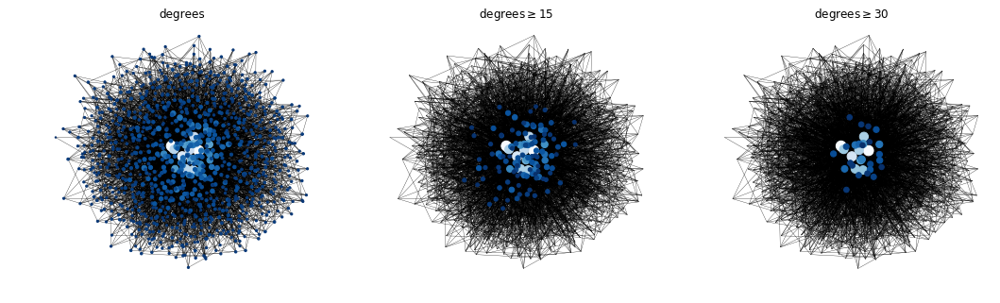

In [18]:
# observe
fam_list, G = return_family_list()

fig, axes = plt.subplots(1, 3, figsize=(18, 5))
for i in range(3):
    node_size = 5
    node_color = [0]*len(fam_list)
    nodelist = G.nodes()
    plt.subplot(1, 3, i+1)
    nx.draw(G, node_size=0, width=0, pos=nx.spring_layout(G, random_state=1), alpha=1)
    if i==0:
        plt.title("degrees")
        node_size = [d[1] for d in list(G.degree())]
        node_color = [(d-min(node_size))/(max(node_size)-min(node_size)) for d in node_size]
    if i==1:
        plt.title("degrees" + r"$\geq 15$")
        nodelist = [d[0] for d in list(G.degree()) if d[1] >= 15]
        node_size = [G.degree(i) for i in nodelist]
        node_color = [(d-min(node_size))/(max(node_size)-min(node_size)) for d in node_size]
    if i==2:
        plt.title("degrees" + r"$\geq 30$")
        nodelist = [d[0] for d in list(G.degree()) if d[1] >= 30]
        node_size = [G.degree(i) for i in nodelist]
        node_color = [(d-min(node_size))/(max(node_size)-min(node_size)) for d in node_size]
    nx.draw(G, node_size=node_size, node_color=node_color, nodelist=nodelist, width=0.3, pos=nx.spring_layout(G, random_state=1), cmap=plt.cm.Blues_r)
plt.show()

In [19]:
# experiment
from calculator import *
# @return:  illed people [runs:[D:[day:[state]]]]
# /= runs for average
def experiment_3_hubs(Ds=[9999, 15, 30], INFECT_INIT=30, days=10, runs=30, theta=0.1):
    states_each_experiment = np.zeros((runs, len(Ds), days, 1000))
    paras.THETA = theta
    for d, D in enumerate(Ds):
        fam_list, G = return_family_list(n=1000)
        cal = Calculator(fam_list)

        for r in trange(runs):
            cal.cls()
            infects = []
            while len(infects) < INFECT_INIT:
                i = np.random.randint(0, len(fam_list))
                infects.append(i)
            for i in infects:
                fam_list[i].state = 5

            # control hubs
            for fam in fam_list:
                fam.seal = False
            nodelist = [degree[0] for degree in list(G.degree()) if degree[1] >= D]
            for fam in fam_list:
                if fam.label in nodelist:
                    fam.seal = True

            # cal.next_iter(days) returns [day:[state, state, state]]
            each_experiment = np.array(cal.next_iter(days))
            states_each_experiment[r, d] = each_experiment
    return states_each_experiment

In [20]:
# experiment 3
ex_3_data = experiment_3_hubs()

100%|██████████| 30/30 [00:02<00:00, 13.91it/s]


In [21]:
# data
run_D_day_state = np.where(ex_3_data==0, 0, 1)

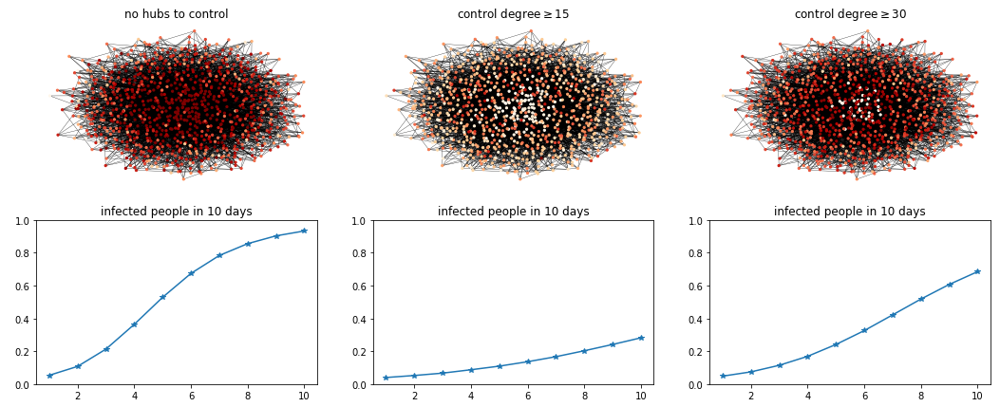

In [22]:
# show results
Ds = [9999, 15, 30]
fam_list, G = return_family_list(n=1000)
D_day = run_D_day_state.mean(axis=0).mean(axis=2)

fig, axes = plt.subplots(2, 3, figsize=(18, 7))
for i, D in enumerate(Ds):
    plt.subplot(2, 3, i+1)
    states = run_D_day_state[:, i, 9, :].mean(axis=0)
    nx.draw(G, node_size=5, node_color=states, width=0.3, pos=nx.spring_layout(G, random_state=1), cmap=plt.cm.OrRd)
    if i==0:
        plt.title('no hubs to control')
    else:
        plt.title('control degree' + r'$\geq$' + str(D))
    plt.subplot(2, 3, i+4)
    plt.plot(np.arange(1, 11), D_day[i], '*-')
    plt.ylim(0, 1)
    plt.title('infected people in 10 days')
plt.show()

可见，管控 hubs 确实能一定程度上抑制疫情。 

### 实验4：快结束时也不能掉以轻心

In [23]:
# experiment
from calculator import *
# @return:  illed people [day:[state]]
def experiment_4_guard(INFECT_INIT=30, flag=0):
    fam_list, G = return_family_list()
    cal = Calculator(fam_list)

    states_each_experiment = list()
    def append_experiment(experiment):
        for states in experiment:
            states_each_experiment.append(states)

    day = 0
    while day < 50:
        if day == 0:
            infects = []
            while len(infects) < INFECT_INIT:
                i = np.random.randint(0, len(fam_list))
                infects.append(i)
            for i in infects:
                fam_list[i].state = 5
            paras.THETA = 0.05
        if day >= 7 and day <= 10:
            paras.THETA *= 0.5
            paras.ETA = min(1, paras.ETA * 1.5)
        if day > 18 and flag==0:
            paras.THETA = 0.05
        if day > 24 and flag==1:
            paras.THETA = 0.05

        each_experiment = np.array(cal.next_iter(1))
        append_experiment(each_experiment)
        day += 1

    return np.asarray(states_each_experiment)

In [24]:
ex_4_data = experiment_4_guard()

In [25]:
S_number_list = np.where(ex_4_data==0, 1, 0).sum(axis=1) / 1000
E_number_list = np.where(ex_4_data>0, 1, 0).sum(axis=1) / 1000
I_number_list = np.where(ex_4_data==-1, 1, 0).sum(axis=1) / 1000
R_number_list = np.where(ex_4_data==-2, 1, 0).sum(axis=1) / 1000

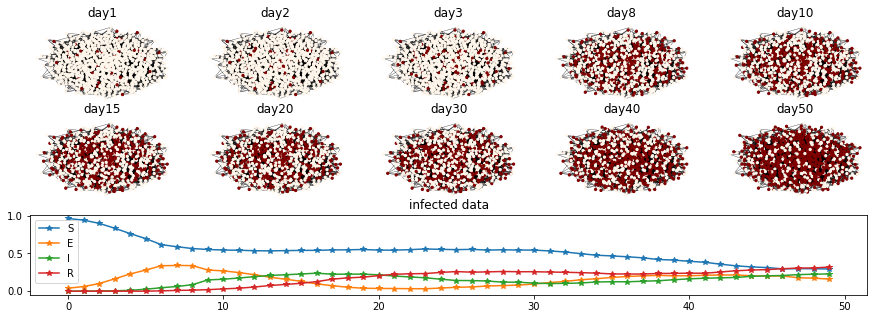

In [26]:
Days = [1, 2, 3, 8, 10, 15, 20, 30, 40, 50]

fig, axes = plt.subplots(3, 5, figsize=(15, 5))
for i, D in enumerate(Days):
    plt.subplot(3, 5, i+1)
    ex_4_data_tmp = np.where(ex_4_data==0, 0, 1)
    states = ex_4_data_tmp[D-1, :]
    nx.draw(G, node_size=5, node_color=states, width=0.3, pos=nx.spring_layout(G, random_state=1), cmap=plt.cm.OrRd)
    plt.title('day' + str(D))
plt.subplot(3, 1, 3)
plt.plot(S_number_list, '*-')
plt.plot(E_number_list, '*-')
plt.plot(I_number_list, '*-')
plt.plot(R_number_list, '*-')
plt.title('infected data')
plt.legend(['S', 'E', 'I', 'R'])
plt.show()

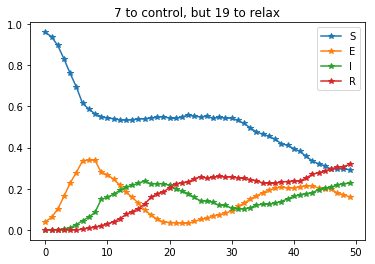

In [27]:
plt.plot(S_number_list, '*-')
plt.plot(E_number_list, '*-')
plt.plot(I_number_list, '*-')
plt.plot(R_number_list, '*-')
plt.title('7 to control, but 19 to relax')
plt.legend(['S', 'E', 'I', 'R'])
plt.show()

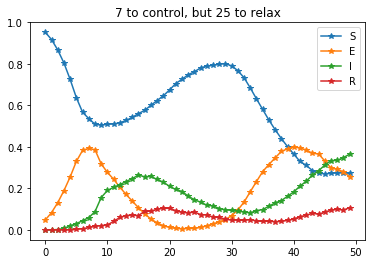

In [28]:
ex_4_data = experiment_4_guard(flag=1)
S_number_list = np.where(ex_4_data==0, 1, 0).sum(axis=1) / 1000
E_number_list = np.where(ex_4_data>0, 1, 0).sum(axis=1) / 1000
I_number_list = np.where(ex_4_data==-1, 1, 0).sum(axis=1) / 1000
R_number_list = np.where(ex_4_data==-2, 1, 0).sum(axis=1) / 1000
plt.plot(S_number_list, '*-')
plt.plot(E_number_list, '*-')
plt.plot(I_number_list, '*-')
plt.plot(R_number_list, '*-')
plt.title('7 to control, but 25 to relax')
plt.legend(['S', 'E', 'I', 'R'])
plt.show()

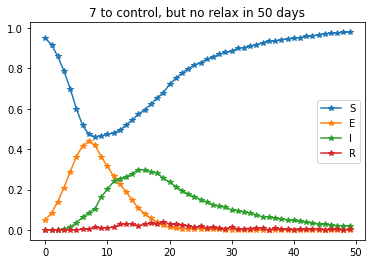

In [29]:
ex_4_data = experiment_4_guard(flag=2)
S_number_list = np.where(ex_4_data==0, 1, 0).sum(axis=1) / 1000
E_number_list = np.where(ex_4_data>0, 1, 0).sum(axis=1) / 1000
I_number_list = np.where(ex_4_data==-1, 1, 0).sum(axis=1) / 1000
R_number_list = np.where(ex_4_data==-2, 1, 0).sum(axis=1) / 1000
plt.plot(S_number_list, '*-')
plt.plot(E_number_list, '*-')
plt.plot(I_number_list, '*-')
plt.plot(R_number_list, '*-')
plt.title('7 to control, but no relax in 50 days')
plt.legend(['S', 'E', 'I', 'R'])
plt.show()